# Data cleaning

 1. Delete unnecessary comentary lines
 
 2. Modify date/time format
 
 3. Validate the data and identify no data
    
 4. How to handle NaN values?

In [68]:
# import modules
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import datetime
import re

import plotly.graph_objects as go
import plotly.express as px

In [69]:
Gauge = 'CAS'
Year = '2010'

file_in = '/media/jihwan/DATA/Tide_gauges/jihwan/IG'+Gauge+'.'+Year+'.VTZ.asc'
file_clean = '/media/jihwan/DATA/Tide_gauges/jihwan/IG'+Gauge+'.'+Year+'.VTZ.asc'
fname_clean_1min = '/media/jihwan/DATA/Tide_gauges/jihwan/1min/'+Gauge+'/IG'+Gauge+'.'+Year+'.fillna0.pkl'

with open(file_in, "r") as f:
    lines = f.readlines()

# Eliminate comment lines and replace T by \t

with open(file_clean, "w") as f:
    for line in lines:
        if line[:10] != "TIMESERIES":
            line = re.sub('T', '\t', line)
            f.write(line)

In [70]:
# Load data
df = pd.read_csv(file_clean, header=None, sep="\s+")

In [71]:
# Set the column names
df.columns = ['date', 'time', 'eta' ]
print(df.shape)
print(df.head())

(11561534, 3)
         date             time   eta
0  2010-01-11  00:00:02.500000  1090
1  2010-01-11  00:00:04.999999  1094
2  2010-01-11  00:00:12.500000  1078
3  2010-01-11  00:00:14.999999  1078
4  2010-01-11  00:00:17.499998  1103


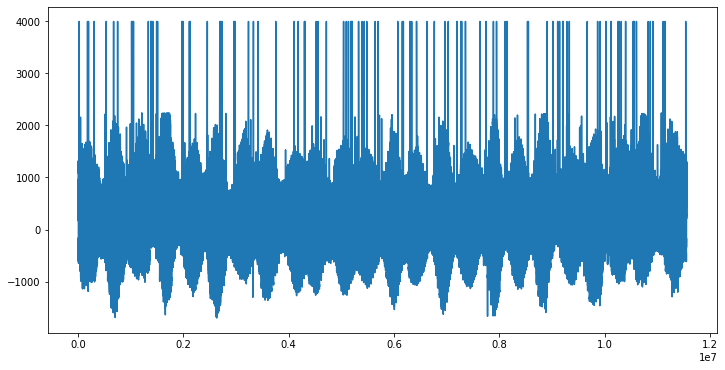

In [72]:
# Plot data
fig = plt.figure(figsize=(12,6))
plt.plot(df['eta'])
plt.show()

Some values do not seem to be correct and we will remove those values.

In [73]:
# find the maximum value
print(df['eta'].max())

3990


In [74]:
ind_outlier = df[df['eta']==df['eta'].max()].index
ind_drop = ind_outlier
# remove values before and after this value
ind_drop = ind_drop.union(ind_outlier-1) 
ind_drop = ind_drop.union(ind_outlier+1)

# remove the strange values
df_clean = df.drop(ind_drop)

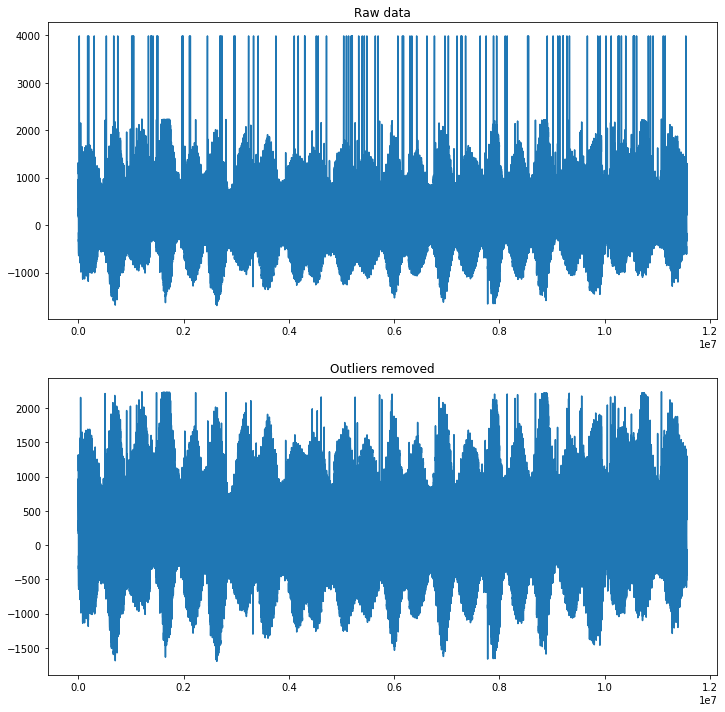

In [75]:
# plot the results
fig = plt.figure(figsize=(12,12))
plt.subplot(2,1,1)
plt.plot(df['eta'])
plt.title('Raw data')
plt.subplot(2,1,2)
plt.plot(df_clean['eta'])
plt.title('Outliers removed')
plt.show()

It looks better, but some data still seem to be off. We may perform similar data cleaning process. But I will use these data. 

In [76]:
# Add date and time columns into datetime
df_clean.loc[:,'datetime'] = df_clean.loc[:,'date']+' '+ df_clean.loc[:,'time']
df_clean.loc[:,'datetime'] = pd.to_datetime(df_clean['datetime'] )
df_clean['datetime'] = df_clean['datetime'].dt.round('1ms')
t0 = df_clean.loc[0,'datetime']

In [77]:
# Drop unnecessary columns
df_clean.drop(['date', 'time'], axis=1, inplace=True)
print(df_clean.head())

    eta                datetime
0  1090 2010-01-11 00:00:02.500
1  1094 2010-01-11 00:00:05.000
2  1078 2010-01-11 00:00:12.500
3  1078 2010-01-11 00:00:15.000
4  1103 2010-01-11 00:00:17.500


In [78]:
# Change the index to datetime
df_clean.set_index('datetime', inplace = True)
print(df_clean.head())

                          eta
datetime                     
2010-01-11 00:00:02.500  1090
2010-01-11 00:00:05.000  1094
2010-01-11 00:00:12.500  1078
2010-01-11 00:00:15.000  1078
2010-01-11 00:00:17.500  1103


In [79]:
# remove duplicated data
df_clean = df_clean.loc[~df_clean.index.duplicated(keep='first')]
df_clean.sort_index(inplace=True)

# create uniform index 
t0 = df_clean.index[0] 
tf = df_clean.index[-1]
idx = pd.date_range(t0, tf, freq='2S500ms')

# Combine and fill in NaN with the nearest value
# Use ffill or bfill instead?
# We need to be careful on this choice
df_clean = df_clean.reindex(idx, method = 'nearest')
print(df_clean.head())

                          eta
2010-01-11 00:00:02.500  1090
2010-01-11 00:00:05.000  1094
2010-01-11 00:00:07.500  1094
2010-01-11 00:00:10.000  1078
2010-01-11 00:00:12.500  1078


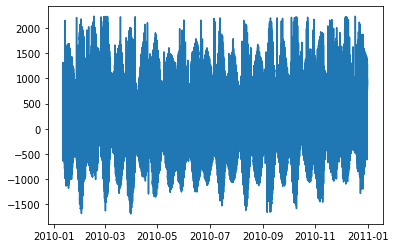

In [80]:
plt.plot(df_clean['eta'])
plt.show()

In [81]:
df_min = df_clean
df_min.index = df_min.index.round('min')

In [82]:
df_clean_1min = df_min.groupby(df_min.index).mean()
print(df_clean_1min)

                             eta
2010-01-11 00:00:00  1117.500000
2010-01-11 00:01:00  1138.695652
2010-01-11 00:02:00  1150.880000
2010-01-11 00:03:00  1132.608696
2010-01-11 00:04:00  1120.400000
...                          ...
2010-12-31 12:14:00  1074.320000
2010-12-31 12:15:00  1070.173913
2010-12-31 12:16:00  1046.440000
2010-12-31 12:17:00  1040.391304
2010-12-31 12:18:00  1032.000000

[510499 rows x 1 columns]


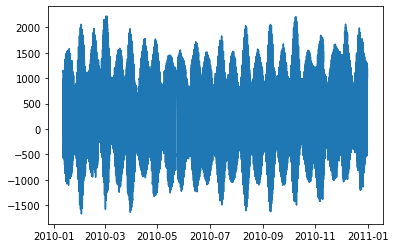

In [83]:
plt.plot(df_clean_1min.index, df_clean_1min['eta'])
plt.show()

In [84]:
print(df_clean_1min.head())

                             eta
2010-01-11 00:00:00  1117.500000
2010-01-11 00:01:00  1138.695652
2010-01-11 00:02:00  1150.880000
2010-01-11 00:03:00  1132.608696
2010-01-11 00:04:00  1120.400000


In [86]:
# Plotly is an interactive plotter

fig = go.Figure()

# Add traces
fig.add_trace(go.Scatter(x=df_clean_1min.index, y=df_clean_1min['eta'],
                    mode='markers',
                    name='markers'))

fig.update_traces(marker=dict(size=2,),
                  selector=dict(mode='markers'))
fig.show()

In [44]:
df_clean_1min.to_pickle(fname_clean_1min)